# **Import Libraries**

In [1]:
!pip install ultralytics

In [2]:
# Import all necessary libraries
from ultralytics import YOLO
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import seaborn as sns
from tqdm.notebook import tqdm

# **Setup and Configuration**

In [3]:
print("\n========== SECTION 1: Setup and Configuration ==========")

class Config:
    DATASET_PATH = 'action-detectionnormalstealingpeakingsneaking'
    TRAIN_DIR = os.path.join(DATASET_PATH, 'train')
    TEST_DIR = os.path.join(DATASET_PATH, 'test')
    CLASSES = ['Normal', 'Peaking', 'Sneaking', 'Stealing']
    CONF_THRESHOLD = 0.25
    BATCH_SIZE = 16
    IMG_SIZE = 640

model = YOLO('/kaggle/input/yolo11/pytorch/default/1/yolo11l.pt')
print("Model loaded successfully!")


========== SECTION 1: Setup and Configuration ==========
Model loaded successfully!


# **Data Exploration**


Dataset Distribution =>
Normal   - Train: 1193 images, Test:  123 images
Peaking  - Train: 1117 images, Test:  122 images
Sneaking - Train:  983 images, Test:  121 images
Stealing - Train: 1275 images, Test:  131 images

Total images in dataset: 5065


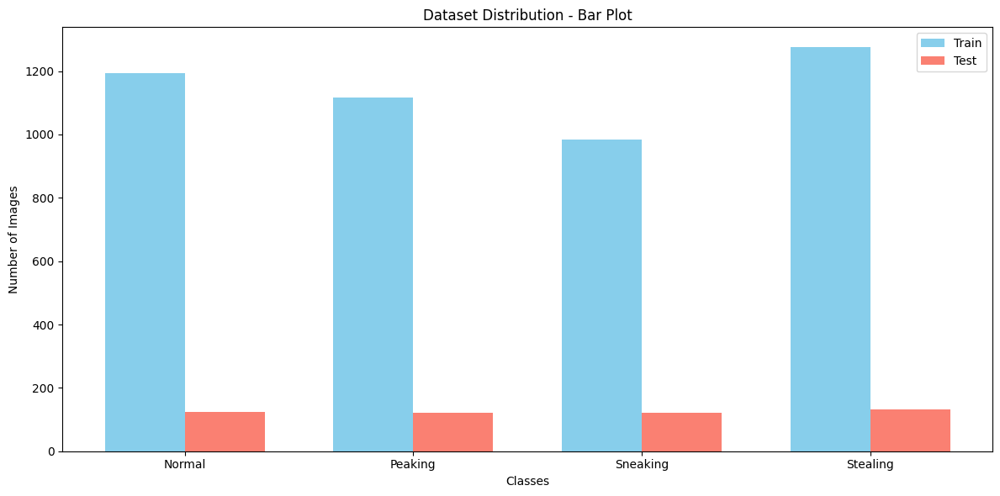

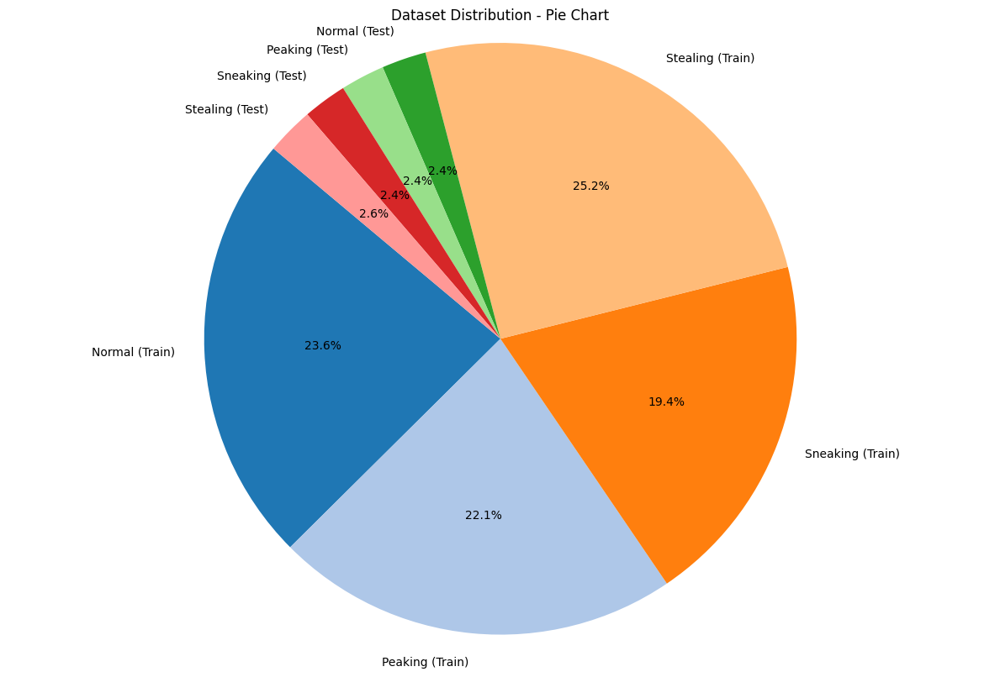

In [4]:
def explore_dataset():
    """Explore and visualize the dataset"""
    class_counts = {}
    total_train_images = 0
    total_test_images = 0
    
    print("\nDataset Distribution =>")
    
    for class_name in Config.CLASSES:
        train_count = len(os.listdir(os.path.join(Config.TRAIN_DIR, class_name)))
        test_count = len(os.listdir(os.path.join(Config.TEST_DIR, class_name)))
        class_counts[class_name] = {'train': train_count, 'test': test_count}
        total_train_images += train_count
        total_test_images += test_count
        print(f"{class_name:8} - Train: {train_count:4} images, Test: {test_count:4} images")
    
    total_images = total_train_images + total_test_images
    print(f"\nTotal images in dataset: {total_images}")
    
    plt.figure(figsize=(12, 6))
    x = np.arange(len(Config.CLASSES))
    width = 0.35
    
    plt.bar(x - width/2, [counts['train'] for counts in class_counts.values()], width, label='Train', color='skyblue')
    plt.bar(x + width/2, [counts['test'] for counts in class_counts.values()], width, label='Test', color='salmon')
    
    plt.xlabel('Classes')
    plt.ylabel('Number of Images')
    plt.title('Dataset Distribution - Bar Plot')
    plt.xticks(x, Config.CLASSES)
    plt.legend()
    plt.tight_layout()
    plt.show()

    pie_labels = [f"{class_name} (Train)" for class_name in Config.CLASSES] + \
                 [f"{class_name} (Test)" for class_name in Config.CLASSES]
    pie_sizes = [counts['train'] for counts in class_counts.values()] + \
                [counts['test'] for counts in class_counts.values()]
    pie_colors = plt.cm.tab20.colors[:len(pie_sizes)]

    plt.figure(figsize=(12, 8))
    plt.pie(pie_sizes, labels=pie_labels, autopct='%1.1f%%', startangle=140, colors=pie_colors)
    plt.title('Dataset Distribution - Pie Chart')
    plt.axis('equal')  
    plt.tight_layout()
    plt.show()

explore_dataset()

# **Display sample Images**


Displaying sample images...


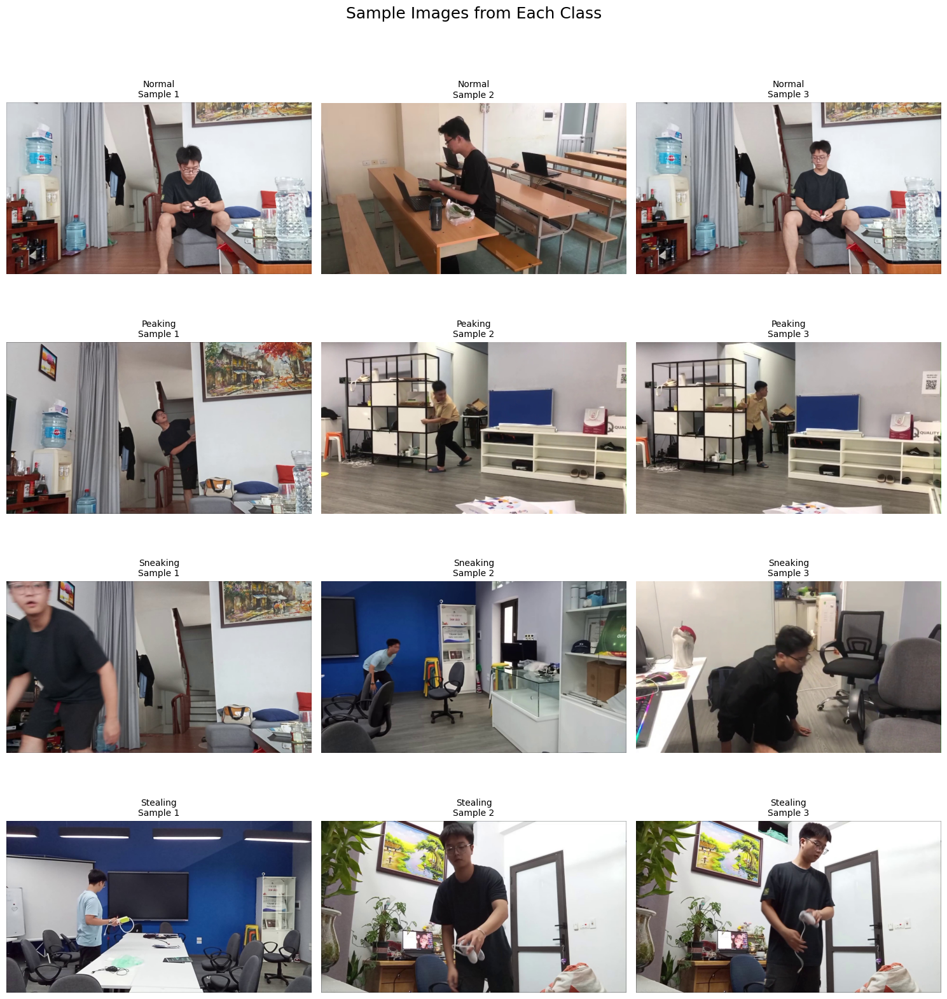

In [5]:
def show_sample_images(num_samples=3):
    """Display sample images from each class"""
    num_classes = len(Config.CLASSES)
    total_images = num_classes * num_samples
    cols = num_samples
    rows = (total_images + cols - 1) // cols  

    plt.figure(figsize=(15, rows * 4))

    for idx, class_name in enumerate(Config.CLASSES):
        class_path = os.path.join(Config.TRAIN_DIR, class_name)
        images = os.listdir(class_path)
        
        for sample_idx in range(num_samples):
            img_path = os.path.join(class_path, np.random.choice(images))
            img = Image.open(img_path)

            subplot_idx = idx * num_samples + sample_idx + 1
            plt.subplot(rows, cols, subplot_idx)
            plt.imshow(img)
            plt.title(f'{class_name}\nSample {sample_idx + 1}', fontsize=10)
            plt.axis('off')

    plt.suptitle('Sample Images from Each Class', fontsize=18, y=1.02)
    plt.tight_layout()
    plt.show()

print("\nDisplaying sample images...")
show_sample_images(num_samples=3)

# **Model Predictions**


========== SECTION 3: Model Predictions ==========

Testing one image per class with different confidence thresholds...

Confidence Threshold: 0.25

Processing class 'Normal' with image 'Normal_76.jpg':

0: 384x640 1 person, 1 parking meter, 1 backpack, 433.2ms
Speed: 2.9ms preprocess, 433.2ms inference, 7.9ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.92)
Detected backpack (Confidence: 0.83)
Detected parking meter (Confidence: 0.28)


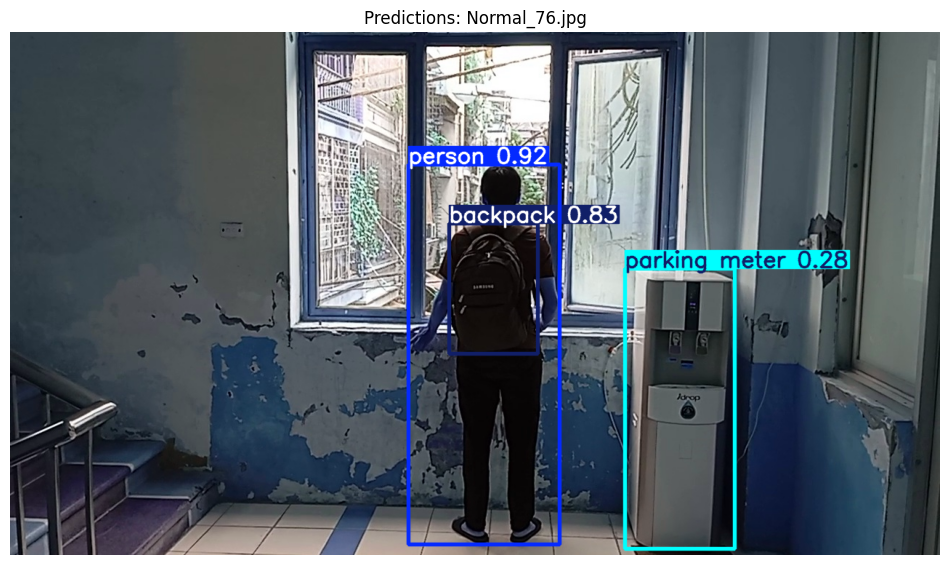


Processing class 'Peaking' with image 'Peaking_33.jpg':

0: 384x640 1 person, 1 backpack, 362.6ms
Speed: 4.3ms preprocess, 362.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.82)
Detected backpack (Confidence: 0.68)


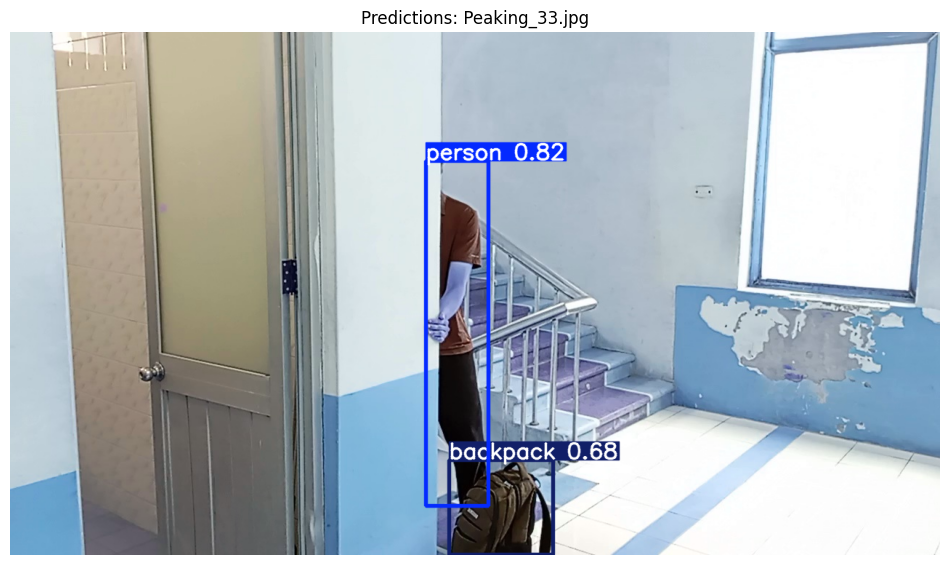


Processing class 'Sneaking' with image 'Sneaking_86.jpg':

0: 384x640 1 person, 359.0ms
Speed: 4.7ms preprocess, 359.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.96)


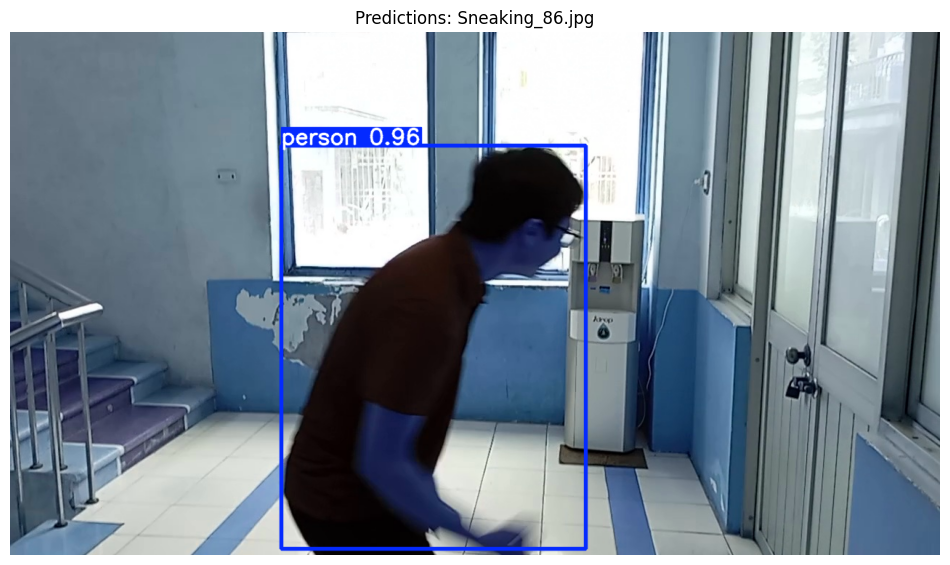


Processing class 'Stealing' with image 'Stealing_54.jpg':

0: 384x640 1 person, 1 backpack, 1 refrigerator, 318.6ms
Speed: 0.0ms preprocess, 318.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.94)
Detected refrigerator (Confidence: 0.73)
Detected backpack (Confidence: 0.54)


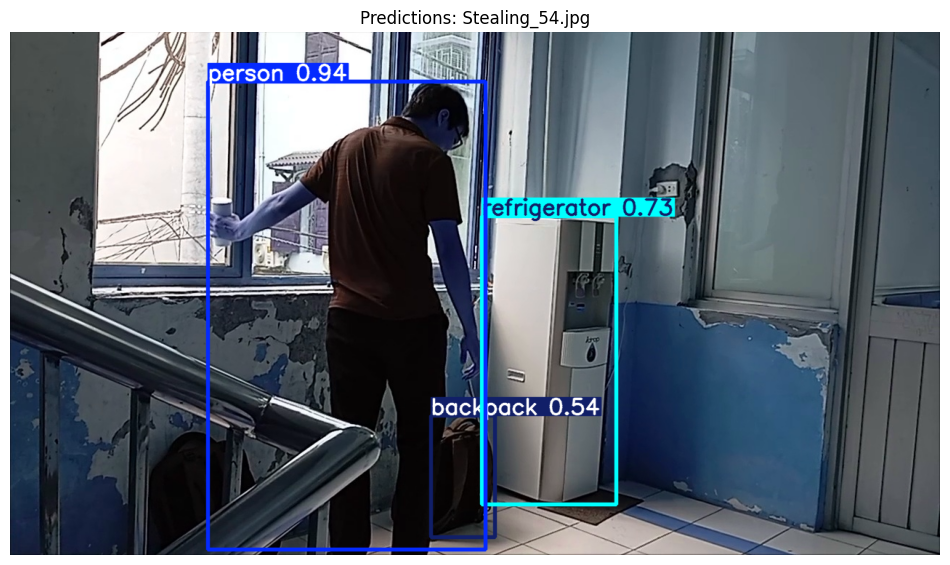


Confidence Threshold: 0.5

Processing class 'Normal' with image 'Normal_21.jpg':

0: 384x640 1 person, 1 backpack, 334.9ms
Speed: 3.2ms preprocess, 334.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.90)
Detected backpack (Confidence: 0.84)


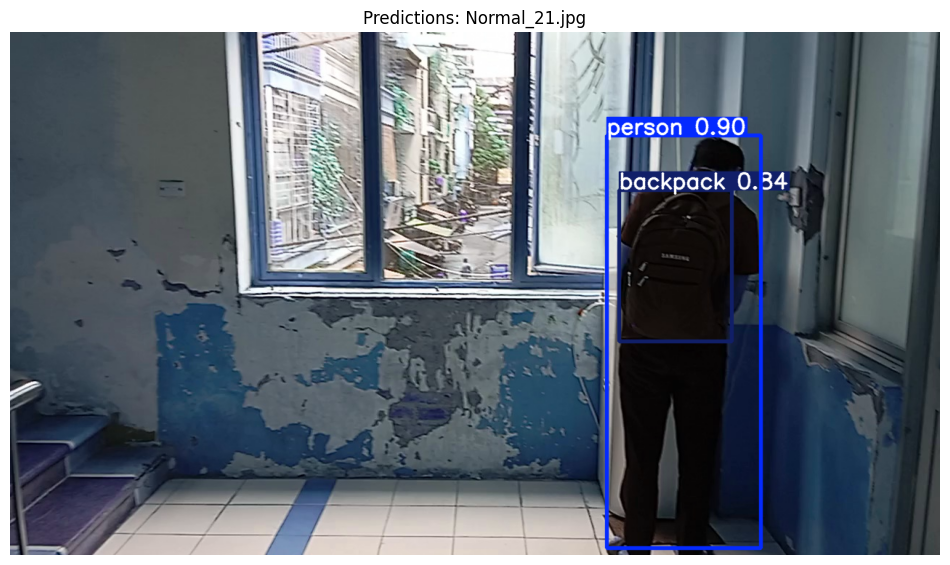


Processing class 'Peaking' with image 'Peaking_81.jpg':

0: 384x640 1 person, 1 backpack, 324.9ms
Speed: 0.0ms preprocess, 324.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.94)
Detected backpack (Confidence: 0.78)


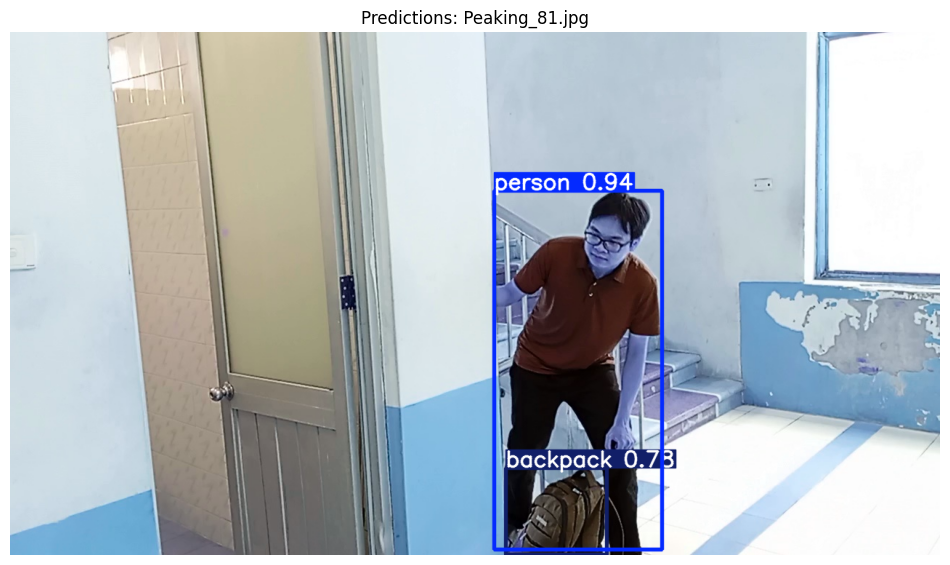


Processing class 'Sneaking' with image 'Sneaking_72.jpg':

0: 384x640 1 person, 308.5ms
Speed: 15.7ms preprocess, 308.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.92)


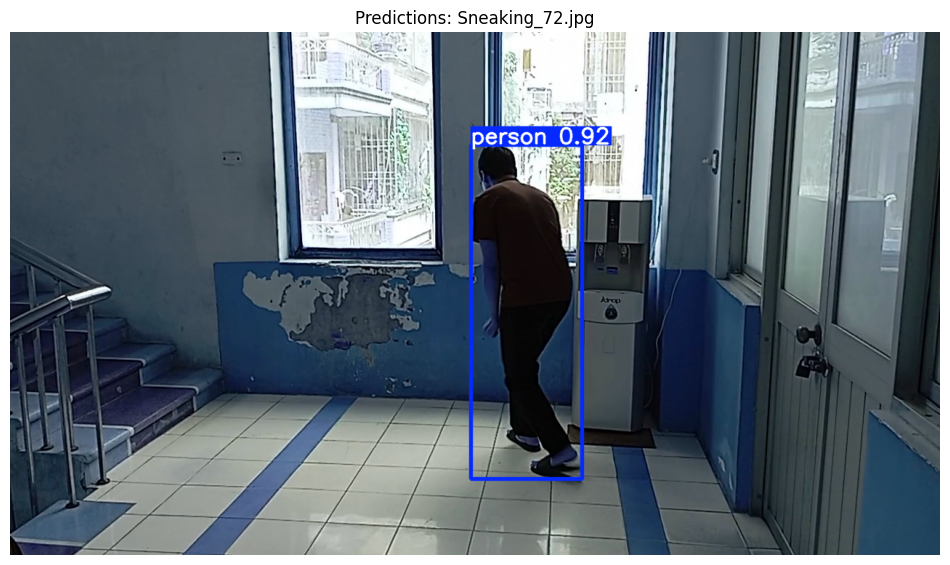


Processing class 'Stealing' with image 'Stealing_22.jpg':

0: 384x640 1 person, 1 backpack, 348.5ms
Speed: 2.0ms preprocess, 348.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected backpack (Confidence: 0.92)
Detected person (Confidence: 0.91)


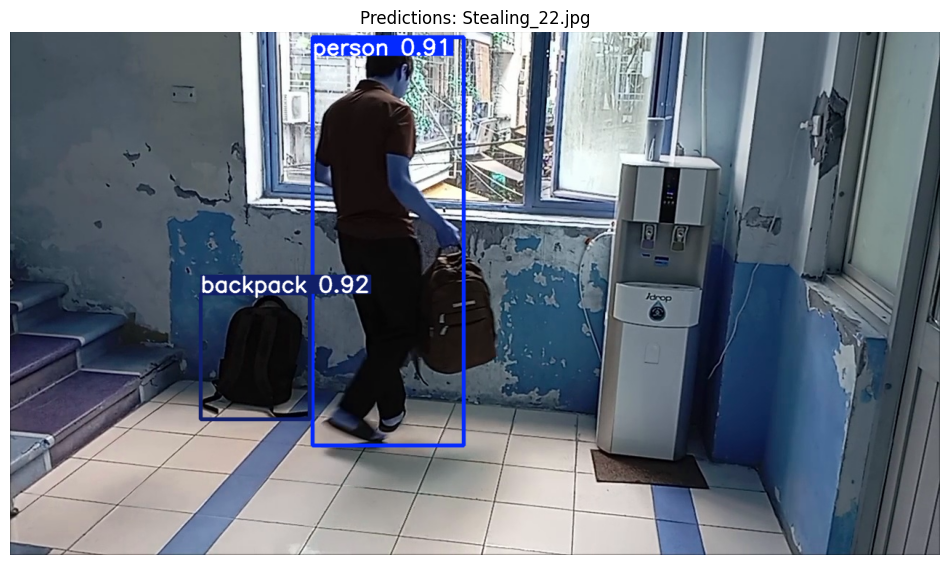


Confidence Threshold: 0.75

Processing class 'Normal' with image 'Normal_96.jpg':

0: 384x640 1 person, 1 backpack, 312.0ms
Speed: 1.1ms preprocess, 312.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.86)
Detected backpack (Confidence: 0.85)


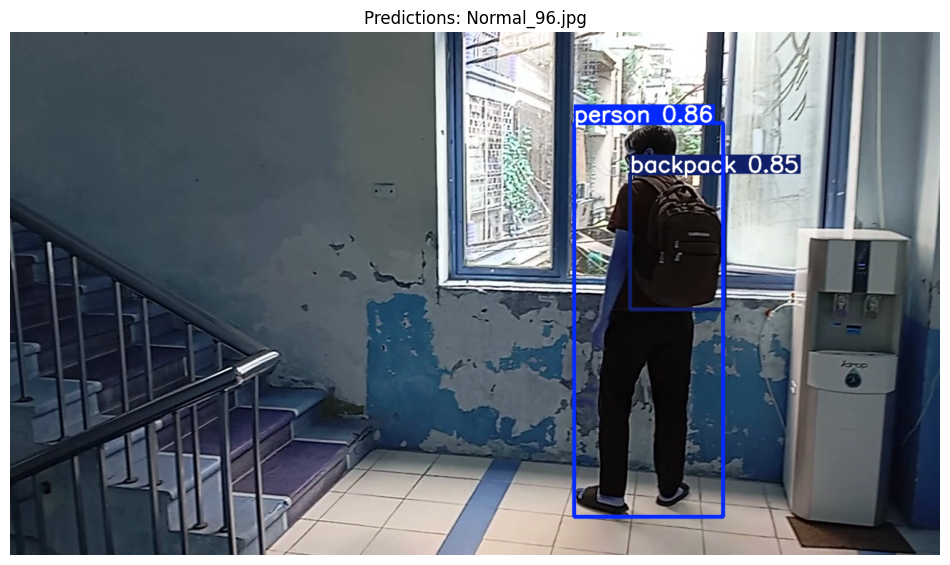


Processing class 'Peaking' with image 'Peaking_98.jpg':

0: 384x640 1 person, 359.7ms
Speed: 0.0ms preprocess, 359.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.95)


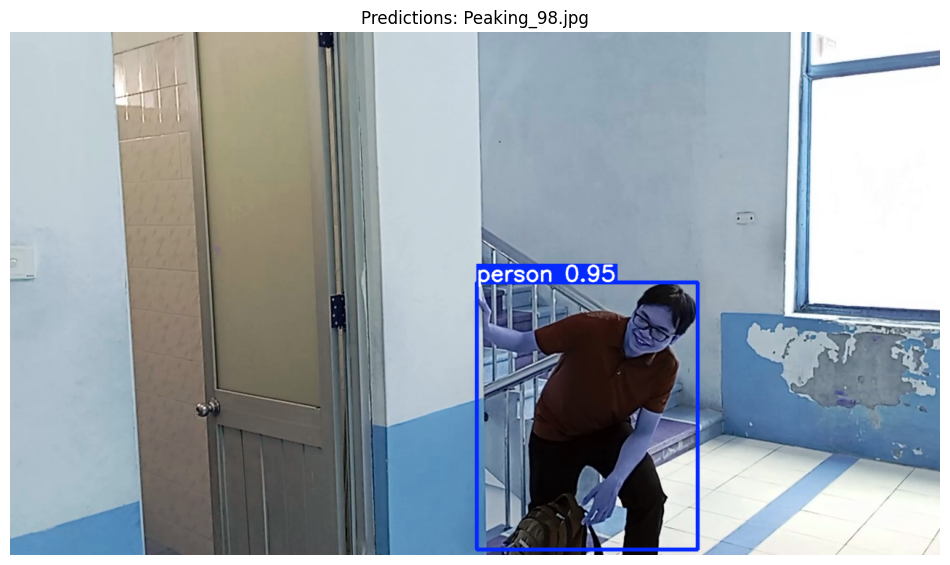


Processing class 'Sneaking' with image 'Sneaking_43.jpg':

0: 384x640 1 person, 328.1ms
Speed: 2.5ms preprocess, 328.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.91)


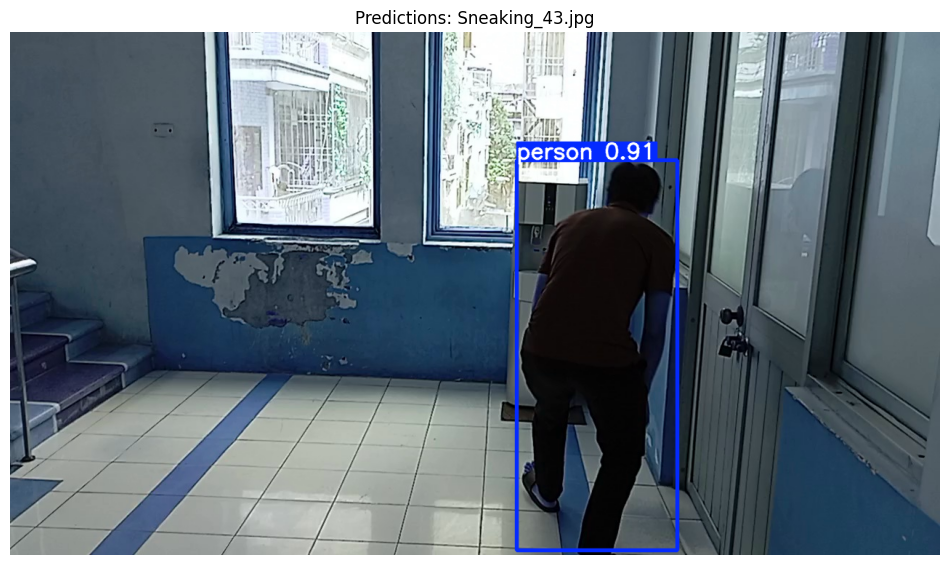


Processing class 'Stealing' with image 'Stealing_104.jpg':

0: 384x640 1 backpack, 332.9ms
Speed: 0.0ms preprocess, 332.9ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)
Detected backpack (Confidence: 0.84)


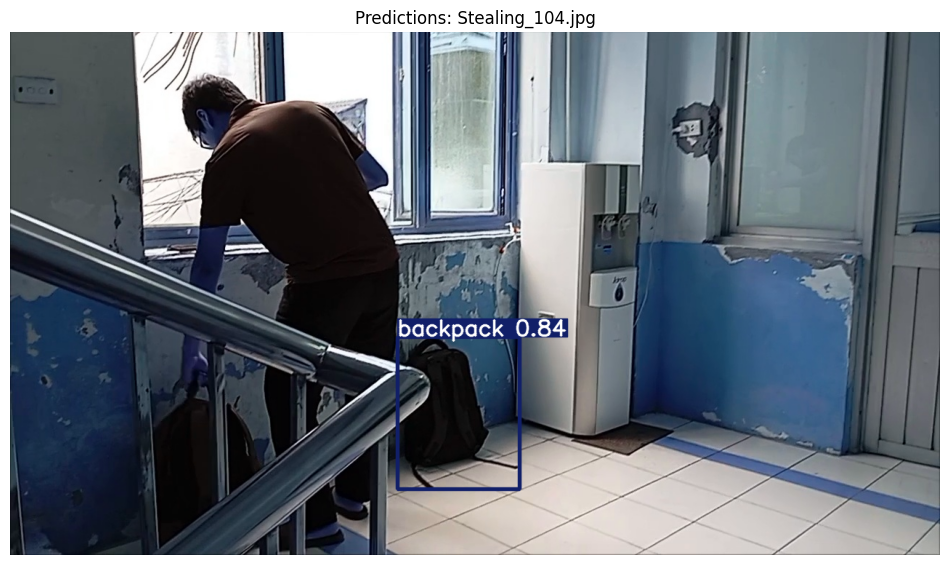

In [6]:
print("\n========== SECTION 3: Model Predictions ==========")

def predict_and_display(image_path, conf_threshold=Config.CONF_THRESHOLD):
    """Make and display predictions on a single image"""
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    results = model.predict(
        source=img,
        conf=conf_threshold,
        show=False
    )

    plt.figure(figsize=(12, 8))
    for r in results:
        im_array = r.plot()
        plt.imshow(cv2.cvtColor(im_array, cv2.COLOR_BGR2RGB))
        plt.title(f"Predictions: {os.path.basename(image_path)}")
        plt.axis('off')

        for box in r.boxes:
            conf = float(box.conf[0])
            cls = int(box.cls[0])
            cls_name = model.names[cls]
            print(f"Detected {cls_name} (Confidence: {conf:.2f})")

    plt.show()

confidence_thresholds = [0.25, 0.5, 0.75]

print("\nTesting one image per class with different confidence thresholds...")
for conf in confidence_thresholds:
    print(f"\nConfidence Threshold: {conf}")
    for class_name in Config.CLASSES:
        test_class_path = os.path.join(Config.TEST_DIR, class_name)
        if os.path.exists(test_class_path):
            images = os.listdir(test_class_path)
            if images:
                sample_image = os.path.join(test_class_path, np.random.choice(images))
                print(f"\nProcessing class '{class_name}' with image '{os.path.basename(sample_image)}':")
                predict_and_display(sample_image, conf)


# **Batch Processing**


========== SECTION 4: Batch Processing ==========

Processing a batch of test images...

0: 384x640 1 person, 1 car, 1 backpack, 332.0ms
1: 384x640 1 person, 1 cup, 332.0ms
2: 384x640 1 person, 1 backpack, 1 refrigerator, 332.0ms
3: 384x640 1 person, 1 car, 1 backpack, 332.0ms
4: 384x640 1 person, 1 backpack, 332.0ms
5: 384x640 1 person, 1 backpack, 332.0ms
6: 384x640 1 person, 2 backpacks, 332.0ms
7: 384x640 1 person, 1 bottle, 1 cup, 332.0ms
8: 384x640 1 person, 332.0ms
9: 384x640 1 person, 1 backpack, 332.0ms
10: 384x640 1 person, 1 backpack, 332.0ms
11: 384x640 1 person, 1 backpack, 332.0ms
12: 384x640 1 person, 1 backpack, 332.0ms
13: 384x640 1 person, 1 backpack, 332.0ms
14: 384x640 1 person, 1 backpack, 332.0ms
15: 384x640 1 person, 1 backpack, 332.0ms
16: 384x640 1 person, 332.0ms
17: 384x640 1 person, 332.0ms
18: 384x640 1 person, 332.0ms
19: 384x640 1 person, 332.0ms
20: 384x640 1 person, 332.0ms
21: 384x640 1 person, 332.0ms
22: 384x640 1 person, 332.0ms
23: 384x640 1 perso

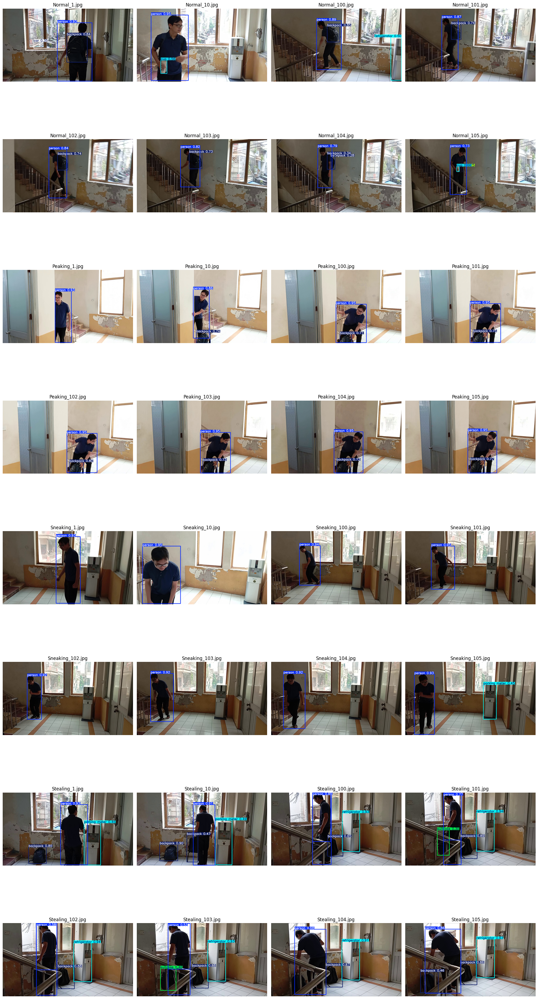


Processed 32 images.


In [7]:
print("\n========== SECTION 4: Batch Processing ==========")

def process_batch(directory, batch_size=Config.BATCH_SIZE):
    """Process multiple images in a batch and display predictions"""
    image_paths = []

    for class_name in Config.CLASSES:
        class_path = os.path.join(directory, class_name)
        if os.path.exists(class_path):
            class_images = os.listdir(class_path)
            image_paths.extend(
                [os.path.join(class_path, img) for img in class_images[:batch_size]]
            )
    
    if not image_paths:
        print("No images found for batch processing.")
        return

    results = model(image_paths, conf=Config.CONF_THRESHOLD)

    num_images = len(image_paths)
    grid_cols = 4
    grid_rows = int(np.ceil(num_images / grid_cols))
    plt.figure(figsize=(20, 5 * grid_rows))
    
    for idx, r in enumerate(results):
        plt.subplot(grid_rows, grid_cols, idx + 1)
        im_array = r.plot()
        plt.imshow(cv2.cvtColor(im_array, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"{os.path.basename(image_paths[idx])}")
    
    plt.tight_layout()
    plt.show()
    print(f"\nProcessed {num_images} images.")

print("\nProcessing a batch of test images...")
process_batch(Config.TEST_DIR, batch_size=8)

# **Analysis**


========== SECTION 5: Detection Analysis ==========


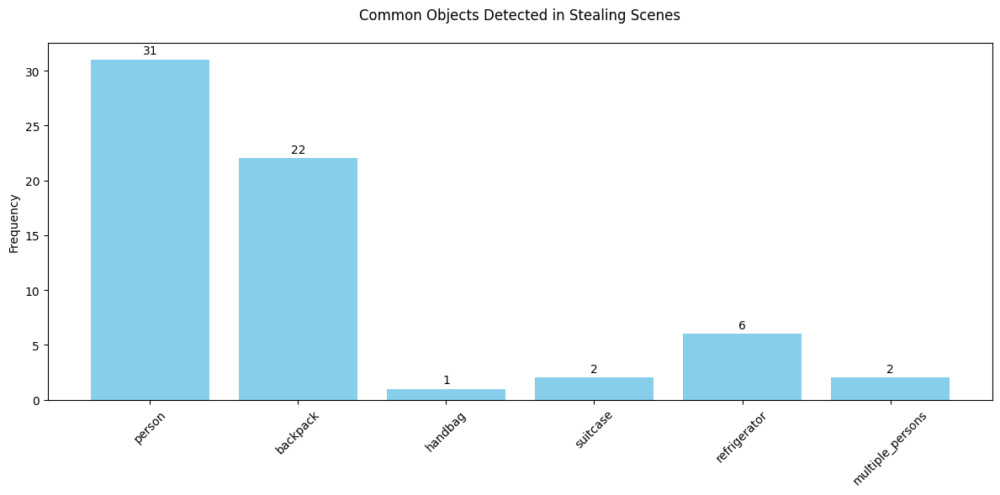


Detection Statistics:
Total images analyzed: 31
person: 31 occurrences (100.0%)
backpack: 22 occurrences (71.0%)
handbag: 1 occurrences (3.2%)
suitcase: 2 occurrences (6.5%)
refrigerator: 6 occurrences (19.4%)
multiple_persons: 2 occurrences (6.5%)

Common Patterns:
- Person with backpack: 22 scenes
- Person with handbag: 1 scenes
- Scenes with refrigerator: 6 scenes

========== SECTION 6: Scene Classification ==========


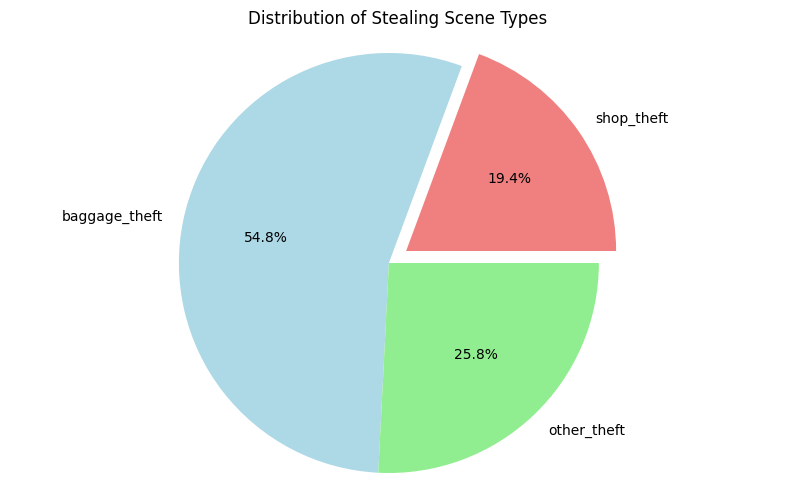


Scene Type Analysis:
shop_theft: 6 scenes
baggage_theft: 17 scenes
other_theft: 8 scenes

Analysis completed!


In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

results = [
    "1 person, 1 toilet",
    "1 person, 1 backpack",
    "1 person, 1 backpack",
    "1 person, 2 backpacks",
    "1 person, 1 parking meter, 1 backpack",
    "1 person, 1 backpack, 1 refrigerator",
    "1 person, 1 parking meter, 1 backpack",
    "1 person, 2 backpacks",
    "1 person, 1 backpack",
    "1 person, 1 backpack",
    "1 person, 1 backpack",
    "1 person, 1 backpack",
    "1 person, 1 backpack",
    "1 person, 1 backpack",
    "1 person, 1 backpack",
    "1 person",
    "1 person",
    "1 person",
    "1 person",
    "1 person",
    "1 person, 1 backpack",
    "1 person",
    "1 person",
    "1 person, 1 handbag, 1 refrigerator",
    "1 person, 1 backpack, 1 refrigerator",
    "1 person, 2 backpacks",
    "2 persons, 1 backpack, 1 suitcase, 1 refrigerator",
    "1 person, 1 backpack",
    "1 person, 1 backpack, 1 refrigerator",
    "1 person, 1 backpack",
    "2 persons, 1 backpack, 1 suitcase, 1 refrigerator"
]

def analyze_stealing_detections():
    detections = {
        'person': 0,
        'backpack': 0,
        'handbag': 0,
        'suitcase': 0,
        'refrigerator': 0,
        'multiple_persons': 0
    }
    
    for line in results:
        if 'persons' in line:
            detections['multiple_persons'] += 1
        if 'person' in line:
            detections['person'] += 1
        if 'backpack' in line:
            detections['backpack'] += 1
        if 'handbag' in line:
            detections['handbag'] += 1
        if 'suitcase' in line or 'suitcases' in line:
            detections['suitcase'] += 1
        if 'refrigerator' in line:
            detections['refrigerator'] += 1
    
    plt.figure(figsize=(12, 6))
    plt.bar(detections.keys(), detections.values(), color='skyblue')
    plt.title('Common Objects Detected in Stealing Scenes', pad=20)
    plt.xticks(rotation=45)
    plt.ylabel('Frequency')
    for i, v in enumerate(detections.values()):
        plt.text(i, v + 0.5, str(v), ha='center')
    plt.tight_layout()
    plt.show()
    
    print("\nDetection Statistics:")
    total_images = len(results)
    print(f"Total images analyzed: {total_images}")
    for obj, count in detections.items():
        percentage = (count / total_images) * 100
        print(f"{obj}: {count} occurrences ({percentage:.1f}%)")
    
    print("\nCommon Patterns:")
    backpack_with_person = sum(1 for line in results if 'person' in line and 'backpack' in line)
    handbag_with_person = sum(1 for line in results if 'person' in line and 'handbag' in line)
    refrigerator_scenes = sum(1 for line in results if 'refrigerator' in line)
    
    print(f"- Person with backpack: {backpack_with_person} scenes")
    print(f"- Person with handbag: {handbag_with_person} scenes")
    print(f"- Scenes with refrigerator: {refrigerator_scenes} scenes")

def classify_stealing_scenes():
    scene_types = {
        'shop_theft': 0,
        'baggage_theft': 0,
        'other_theft': 0
    }
    
    for line in results:
        if 'refrigerator' in line:
            scene_types['shop_theft'] += 1
        elif any(item in line for item in ['backpack', 'handbag', 'suitcase', 'suitcases']):
            scene_types['baggage_theft'] += 1
        else:
            scene_types['other_theft'] += 1
    
    plt.figure(figsize=(10, 6))
    colors = ['lightcoral', 'lightblue', 'lightgreen']
    plt.pie(scene_types.values(), labels=scene_types.keys(), autopct='%1.1f%%', 
            colors=colors, explode=(0.1, 0, 0))
    plt.title('Distribution of Stealing Scene Types')
    plt.axis('equal')
    plt.show()
    
    print("\nScene Type Analysis:")
    for scene_type, count in scene_types.items():
        print(f"{scene_type}: {count} scenes")

print("\n========== SECTION 5: Detection Analysis ==========")
analyze_stealing_detections()

print("\n========== SECTION 6: Scene Classification ==========")
classify_stealing_scenes()

print("\nAnalysis completed!")

# **Live Test on New Image**


Testing suspicious_action1:
Image downloaded successfully

image 1/1 C:\Users\HP\Suspicious Activity Detection using YOLOv11\test_suspicious_action1.jpg: 480x640 2 persons, 1 handbag, 730.6ms
Speed: 6.0ms preprocess, 730.6ms inference, 18.7ms postprocess per image at shape (1, 3, 480, 640)


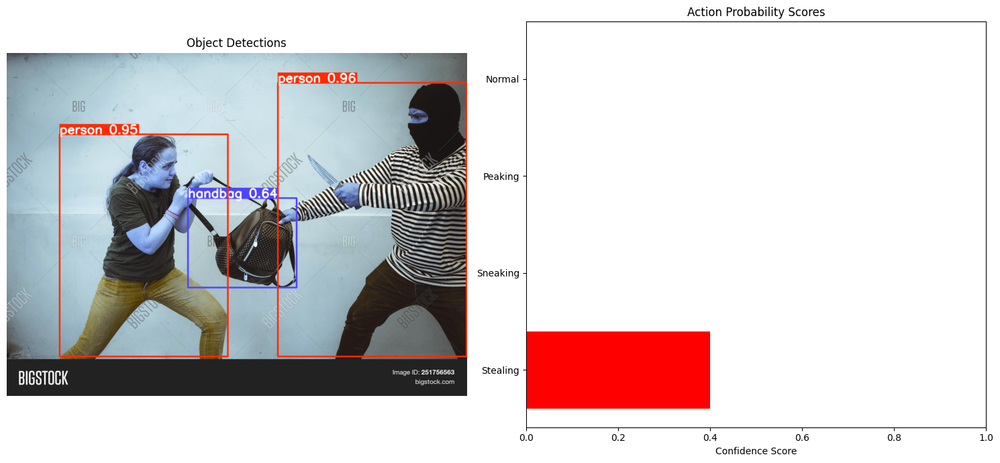


Detected Objects:
- person: 96.08% confidence
- person: 95.05% confidence
- handbag: 64.13% confidence

Action Analysis:
Predicted Action: Stealing (40.00% confidence)

All Action Scores:
- Stealing: 40.00%
- Sneaking: 0.00%
- Peaking: 0.00%
- Normal: 0.00%

Testing suspicious_action2:
Image downloaded successfully

image 1/1 C:\Users\HP\Suspicious Activity Detection using YOLOv11\test_suspicious_action2.jpg: 448x640 1 person, 528.8ms
Speed: 8.1ms preprocess, 528.8ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


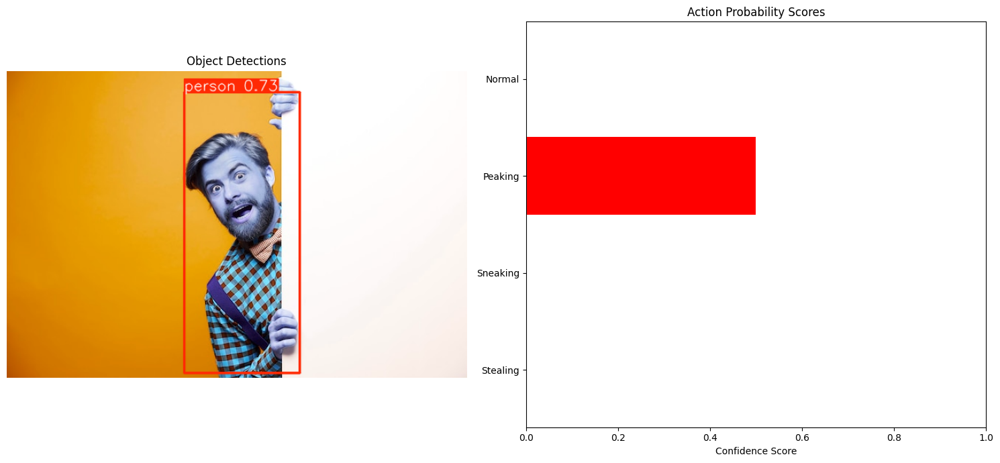


Detected Objects:
- person: 72.68% confidence

Action Analysis:
Predicted Action: Peaking (50.00% confidence)

All Action Scores:
- Stealing: 0.00%
- Sneaking: 0.00%
- Peaking: 50.00%
- Normal: 0.00%

Action detection testing completed!


In [9]:
import urllib.request
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

def detect_action(model, image_path):
    results = model.predict(source=image_path, conf=0.25, save=False)
    result = results[0]
    
    detections = [
        (model.names[int(box.cls[0])], float(box.conf[0]))
        for box in result.boxes
    ]
    
    def classify_action(detections):
        detected_objects = [d[0] for d in detections]
        
        action_scores = {
            'Stealing': 0.0,
            'Sneaking': 0.0,
            'Peaking': 0.0,
            'Normal': 0.0
        }

        if 'person' in detected_objects:
            if any(obj in detected_objects for obj in ['backpack', 'handbag', 'suitcase']):
                action_scores['Stealing'] += 0.4
            if 'refrigerator' in detected_objects:
                action_scores['Stealing'] += 0.3
            if [conf for obj, conf in detections if obj == 'person'][0] < 0.6:
                action_scores['Sneaking'] += 0.5
            if len(detected_objects) <= 2:
                action_scores['Peaking'] += 0.5
        
        if not any(score > 0.3 for score in action_scores.values()):
            action_scores['Normal'] = 0.4
        
        return action_scores

    action_scores = classify_action(detections)

    plt.figure(figsize=(15, 7))

    plt.subplot(1, 2, 1)
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(result.plot())
    plt.title('Object Detections')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    actions = list(action_scores.keys())
    scores = list(action_scores.values())
    colors = ['red' if score == max(scores) else 'blue' for score in scores]
    
    plt.barh(actions, scores, color=colors)
    plt.title('Action Probability Scores')
    plt.xlabel('Confidence Score')
    plt.xlim(0, 1)
    
    plt.tight_layout()
    plt.show()
    
    print("\nDetected Objects:")
    for obj, conf in detections:
        print(f"- {obj}: {conf:.2%} confidence")
    
    print("\nAction Analysis:")
    predicted_action = max(action_scores.items(), key=lambda x: x[1])
    print(f"Predicted Action: {predicted_action[0]} ({predicted_action[1]:.2%} confidence)")
    print("\nAll Action Scores:")
    for action, score in action_scores.items():
        print(f"- {action}: {score:.2%}")

test_urls = {
    'suspicious_action1': 'https://static1.bigstockphoto.com/1/5/2/large1500/251756563.jpg',
    'suspicious_action2': 'https://img.freepik.com/free-photo/portrait-shocked-man-peeking_329181-19905.jpg',
}

for name, url in test_urls.items():
    try:
        print(f"\nTesting {name}:")
        image_path = f'test_{name}.jpg'
        
        opener = urllib.request.build_opener()
        opener.addheaders = [('User-Agent', 'Mozilla/5.0')]
        urllib.request.install_opener(opener)
        
        urllib.request.urlretrieve(url, image_path)
        print("Image downloaded successfully")
        
        detect_action(model, image_path)
        
        os.remove(image_path)
        
    except Exception as e:
        print(f"Error processing {url}: {str(e)}")

print("\nAction detection testing completed!")


Testing Normal:

Error processing ction-detectionnormalstealingpeakingsneaking/test/Normal/Normal_10.jpg: ction-detectionnormalstealingpeakingsneaking/test/Normal/Normal_10.jpg does not exist

Testing Peaking:

image 1/1 C:\Users\HP\Suspicious Activity Detection using YOLOv11\action-detectionnormalstealingpeakingsneaking\test\Peaking\Peaking_10.jpg: 384x640 1 person, 1 backpack, 467.7ms
Speed: 2.0ms preprocess, 467.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


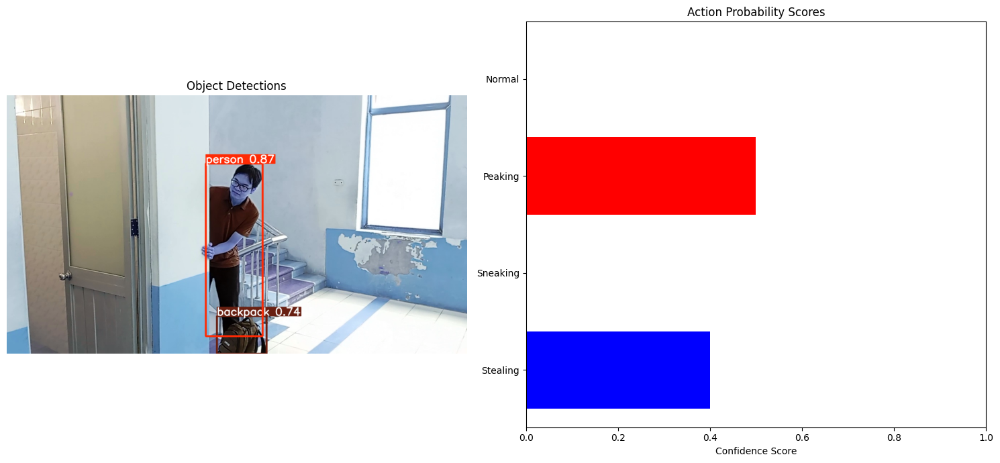


Detected Objects:
- person: 86.54% confidence
- backpack: 73.66% confidence

Action Analysis:
Predicted Action: Peaking (50.00% confidence)

All Action Scores:
- Stealing: 40.00%
- Sneaking: 0.00%
- Peaking: 50.00%
- Normal: 0.00%

Testing Sneaking:

image 1/1 C:\Users\HP\Suspicious Activity Detection using YOLOv11\action-detectionnormalstealingpeakingsneaking\test\Sneaking\Sneaking_10.jpg: 384x640 1 person, 382.8ms
Speed: 2.5ms preprocess, 382.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


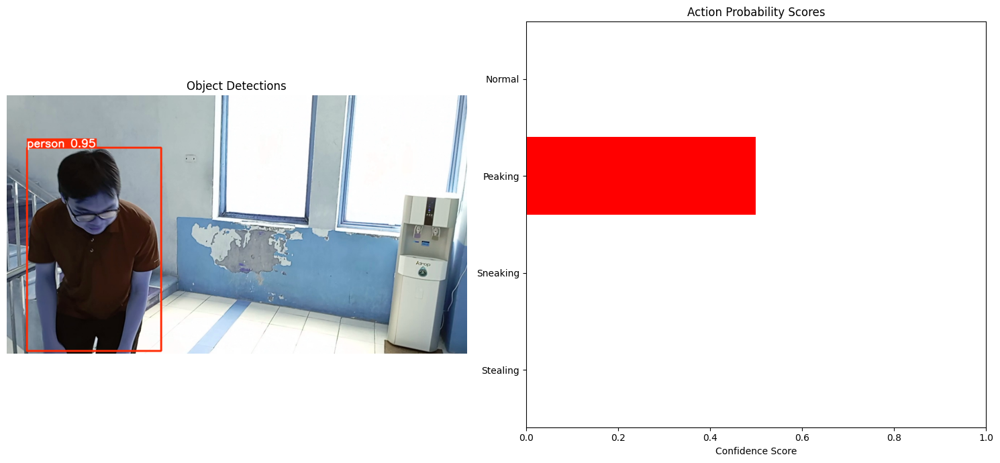


Detected Objects:
- person: 95.20% confidence

Action Analysis:
Predicted Action: Peaking (50.00% confidence)

All Action Scores:
- Stealing: 0.00%
- Sneaking: 0.00%
- Peaking: 50.00%
- Normal: 0.00%

Testing Stealing:

image 1/1 C:\Users\HP\Suspicious Activity Detection using YOLOv11\action-detectionnormalstealingpeakingsneaking\test\Stealing\Stealing_10.jpg: 384x640 1 person, 1 parking meter, 2 backpacks, 361.3ms
Speed: 0.0ms preprocess, 361.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


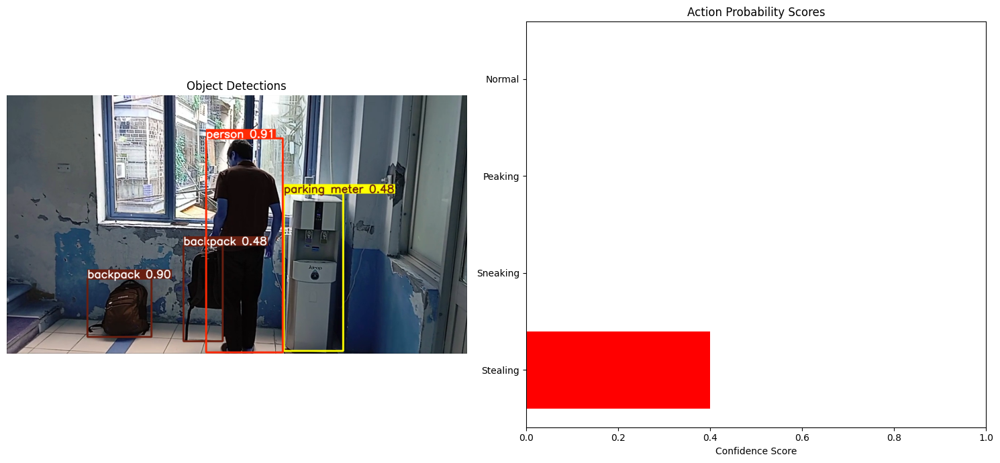


Detected Objects:
- person: 91.24% confidence
- backpack: 89.61% confidence
- parking meter: 47.78% confidence
- backpack: 47.66% confidence

Action Analysis:
Predicted Action: Stealing (40.00% confidence)

All Action Scores:
- Stealing: 40.00%
- Sneaking: 0.00%
- Peaking: 0.00%
- Normal: 0.00%

Action detection testing completed!


In [10]:
def detect_action(model, image_path):
    results = model.predict(source=image_path, conf=0.25, save=False)
    result = results[0]
    
    detections = [
        (model.names[int(box.cls[0])], float(box.conf[0]))
        for box in result.boxes
    ]
    
    def classify_action(detections):
        detected_objects = [d[0] for d in detections]
        
        action_scores = {
            'Stealing': 0.0,
            'Sneaking': 0.0,
            'Peaking': 0.0,
            'Normal': 0.0
        }

        if 'person' in detected_objects:
            if any(obj in detected_objects for obj in ['backpack', 'handbag', 'suitcase']):
                action_scores['Stealing'] += 0.4
            if 'refrigerator' in detected_objects:
                action_scores['Stealing'] += 0.3
            if [conf for obj, conf in detections if obj == 'person'][0] < 0.6:
                action_scores['Sneaking'] += 0.5
            if len(detected_objects) <= 2:
                action_scores['Peaking'] += 0.5
        
        if not any(score > 0.3 for score in action_scores.values()):
            action_scores['Normal'] = 0.4
        
        return action_scores

    action_scores = classify_action(detections)

    plt.figure(figsize=(15, 7))

    plt.subplot(1, 2, 1)
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(result.plot())
    plt.title('Object Detections')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    actions = list(action_scores.keys())
    scores = list(action_scores.values())
    colors = ['red' if score == max(scores) else 'blue' for score in scores]
    
    plt.barh(actions, scores, color=colors)
    plt.title('Action Probability Scores')
    plt.xlabel('Confidence Score')
    plt.xlim(0, 1)
    
    plt.tight_layout()
    plt.show()
    
    print("\nDetected Objects:")
    for obj, conf in detections:
        print(f"- {obj}: {conf:.2%} confidence")
    
    print("\nAction Analysis:")
    predicted_action = max(action_scores.items(), key=lambda x: x[1])
    print(f"Predicted Action: {predicted_action[0]} ({predicted_action[1]:.2%} confidence)")
    print("\nAll Action Scores:")
    for action, score in action_scores.items():
        print(f"- {action}: {score:.2%}")

test_paths = {
    'Normal': 'ction-detectionnormalstealingpeakingsneaking/test/Normal/Normal_10.jpg',
    'Peaking': 'action-detectionnormalstealingpeakingsneaking/test/Peaking/Peaking_10.jpg',
    'Sneaking': 'action-detectionnormalstealingpeakingsneaking/test/Sneaking/Sneaking_10.jpg',
    'Stealing': 'action-detectionnormalstealingpeakingsneaking/test/Stealing/Stealing_10.jpg'
}

for action, image_path in test_paths.items():
    try:
        print(f"\nTesting {action}:")
        detect_action(model, image_path)
    except Exception as e:
        print(f"Error processing {image_path}: {str(e)}")

print("\nAction detection testing completed!")